# World Data League 2022

## 🎯 Challenge
Predicting the flow of people for public transportation improvements



## 👥 Authors
* Akshay Punjabi
* Pablo Izquierdo Ayala
* Enrico Coluccia
* Chiara Rucco

## 💻 Development

### Data Loading

#### Getting the data

In [ ]:
!wget https://wdl-data.fra1.digitaloceanspaces.com/porto/InterMunicipality.zip

In [ ]:
!unzip /content/InterMunicipality.zip

#### Imports

In [ ]:
!pip install catboost shap kaleido eli5

In [ ]:
import glob

import warnings
import matplotlib as mpl
import numpy as np
import pandas as pd 
import statsmodels as sm
import tensorflow as tf
from matplotlib import pyplot as plt
from pylab import rcParams
import datetime

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa import api as smt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import plotly.offline as offline
import plotly.graph_objs as go

from sklearn.multioutput import MultiOutputRegressor
import xgboost as xgb
from catboost import CatBoostRegressor
from catboost import CatBoost, Pool
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, cross_val_predict
from sklearn.metrics import mean_squared_error
import shap

from itertools import cycle

warnings.filterwarnings("ignore")

seed = 42
tf.random.set_seed(seed)
np.random.seed(seed)
plt.style.use('bmh')
mpl.rcParams['axes.labelsize'] = 14
mpl.rcParams['xtick.labelsize'] = 12
mpl.rcParams['ytick.labelsize'] = 12
mpl.rcParams['text.color'] = 'k'
print(tf.__version__)

#### Loading DataFrame

The data provided contains two types of datasets: NOS data and passenger entries per stop. We decide to focus only on passenger data. There are also two types of railway systems: trains and metros. We decide to focus on the metro service.

In [ ]:
%%time
print(f"{'*'*10} Loading Data... {'*'*10}")
filepaths = glob.glob("/content/InterMunicipality/TIP/**/*Ferrov.xlsx", recursive=True)
df = pd.concat(map(pd.read_excel, filepaths))
df.rename(columns={'Ano':'year', 'Mês':'month', 'Dia': 'day','Hora': 'hour', 'Est/Op':'Stop', 'Validações': 'Validations'}, inplace=True)

********** Loading Data... **********
CPU times: user 2min 22s, sys: 736 ms, total: 2min 22s
Wall time: 2min 38s


In [ ]:
df['Date'] = pd.to_datetime(df[['year', 'month', 'day', 'hour']])
df = df[df['Operador'] == 'Metro do Porto']
df.drop(columns=['year', 'month', 'day', 'hour', 'Operador', 'Zona'], inplace=True)

In [ ]:
df

,Stop,Validations,Date
7,Aliados,4,2020-06-01 00:00:00
8,Bolhão,4,2020-06-01 00:00:00
9,Câmara de Gaia,1,2020-06-01 00:00:00
10,Câmara de Matosinhos,2,2020-06-01 00:00:00
11,Carolina de Michaelis,1,2020-06-01 00:00:00
...,...,...,...
81734,Trindade,49,2020-12-31 23:00:00
81735,Vasco da Gama,1,2020-12-31 23:00:00
81736,Venda-a-Nova,1,2020-12-31 23:00:00
81737,Verdes,1,2020-12-31 23:00:00


### Exploratory Data Analysis (EDA)

#### First steps

**Overview**

In [ ]:
df.groupby("Stop").describe()

Validations                                            \
                        count        mean         std  min   25%    50%   
Stop                                                                      
24 de Agosto           6561.0  205.476299  184.021127  1.0  60.0  164.0   
Aeroporto              6143.0   51.911607   62.713647  1.0   8.0   28.0   
Aliados                6545.0  105.794652  113.285259  1.0  28.0   72.0   
Alto da Pêga           5486.0    7.085855    6.045416  1.0   3.0    6.0   
Araújo                 5629.0   11.403091   11.580996  1.0   3.0    8.0   
...                       ...         ...         ...  ...   ...    ...   
Vila do Conde          6122.0   33.961124   36.470999  1.0   8.0   22.0   
Vilar do Pinheiro      5435.0   10.725483   11.548337  1.0   3.0    7.0   
Viso                   6489.0   98.084605   92.439086  1.0  24.0   76.0   
Zona Industrial        5632.0    9.615589   13.688590  1.0   3.0    5.0   
Árvore                 4239.0    3.754187    3.488194  1.0   1.0    3.0   

                                  
                     75%     max  
Stop                              
24 de Agosto       292.0  1116.0  
Aeroporto           69.0   423.0  
Aliados            143.0   757.0  
Alto da Pêga         9.0    50.0  
Araújo              15.0    84.0  
...                  ...     ...  
Vila do Conde       47.0   251.0  
Vilar do Pinheiro   14.0    79.0  
Viso               143.0   678.0  
Zona Industrial     10.0    99.0  
Árvore               5.0    26.0  

[85 rows x 8 columns]

First contact with the data. We already notice that there is huge variability in the number of user entries per stop. This will become relevant later on, as it will help us prioritize between major stops and other stops that are not as important.

**Missing Values**

In [ ]:
print(f'Number of rows: {df.shape[0]};  Number of columns: {df.shape[1]}; Number of missing values: {sum(df.isna().sum())}')

Number of rows: 499537;  Number of columns: 3; Number of missing values: 0


**General information**

In [ ]:
unique_times = df['Date'].unique()
print(f'Number of unique times: {unique_times.shape[0]}')
print(f'Earliest date: {unique_times.min()}')
print(f'Latest date: {unique_times.max()}')

Number of unique times: 7090
Earliest date: 2020-01-01T00:00:00.000000000
Latest date: 2020-12-31T23:00:00.000000000


**Pivoting Table**

This gives us an overview of the number of users per hour

In [ ]:
df = df.set_index('Date')
df = df.pivot_table('Validations', 'Date', 'Stop').reset_index()
df

Stop,Date,24 de Agosto,Aeroporto,Aliados,Alto da Pêga,Araújo,Azurara,Baguim,Bolhão,Botica,...,Trindade,Varziela,Vasco da Gama,Venda-a-Nova,Verdes,Vila do Conde,Vilar do Pinheiro,Viso,Zona Industrial,Árvore
0,2020-01-01 00:00:00,84.0,7.0,NaN,4.0,29.0,6.0,17.0,1149.0,1.0,...,4562.0,15.0,33.0,16.0,3.0,41.0,13.0,69.0,NaN,7.0
1,2020-01-01 01:00:00,134.0,NaN,NaN,5.0,61.0,3.0,15.0,777.0,NaN,...,4250.0,21.0,31.0,17.0,3.0,54.0,12.0,42.0,17.0,6.0
2,2020-01-01 02:00:00,61.0,NaN,NaN,NaN,47.0,1.0,3.0,430.0,NaN,...,2988.0,NaN,33.0,1.0,NaN,13.0,NaN,40.0,11.0,NaN
3,2020-01-01 03:00:00,49.0,NaN,NaN,NaN,1.0,NaN,NaN,250.0,NaN,...,2004.0,NaN,4.0,1.0,NaN,1.0,NaN,17.0,1.0,NaN
4,2020-01-01 04:00:00,33.0,NaN,209.0,NaN,NaN,NaN,NaN,185.0,NaN,...,2287.0,NaN,1.0,1.0,NaN,9.0,NaN,6.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7085,2020-12-31 19:00:00,78.0,5.0,42.0,1.0,NaN,NaN,NaN,115.0,3.0,...,503.0,2.0,6.0,3.0,4.0,6.0,3.0,30.0,1.0,NaN
7086,2020-12-31 20:00:00,48.0,6.0,23.0,NaN,NaN,NaN,2.0,28.0,NaN,...,219.0,2.0,9.0,1.0,1.0,5.0,1.0,12.0,1.0,NaN
7087,2020-12-31 21:00:00,35.0,4.0,16.0,NaN,1.0,NaN,1.0,16.0,NaN,...,147.0,1.0,6.0,NaN,NaN,3.0,NaN,7.0,3.0,NaN
7088,2020-12-31 22:00:00,26.0,NaN,40.0,NaN,NaN,NaN,NaN,25.0,NaN,...,218.0,3.0,5.0,NaN,NaN,2.0,2.0,6.0,1.0,NaN


**Overview plots**

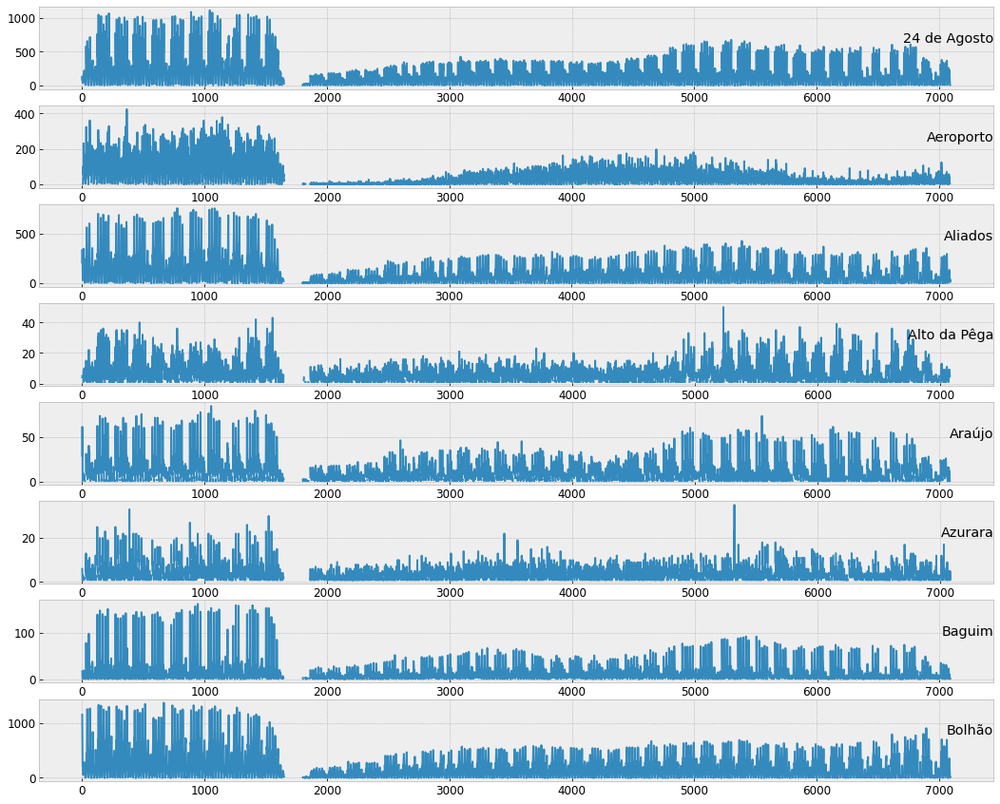

In [ ]:
rcParams['figure.figsize'] = 18, 15
values = df.values
groups = [1, 2, 3, 4, 5, 6, 7, 8]
i = 1
# plot each column
for group in groups:
    plt.subplot(len(groups), 1, i)
    plt.plot(values[:, group])
    plt.title(df.columns[group], y=0.5, loc='right')
    i += 1


plt.show()

Here we just plot a couple stops to see how the timeline evolves. We immediately notice a huge anomaly, as the timeseries seems to be cut in two. We will elaborate further on this in the next sections.

In [ ]:
df = df.fillna(method='ffill')
df.sort_index(inplace = True)
df = df.fillna(0)
pivot = df

#### Looking at seasonal components

After seeing the interesting shape of the timeseries in the previous plots, we decided to look deaper into two stops at random, Aeroporto and Trindade. 

**Aeroporto**

<Figure size 4000x1600 with 0 Axes>

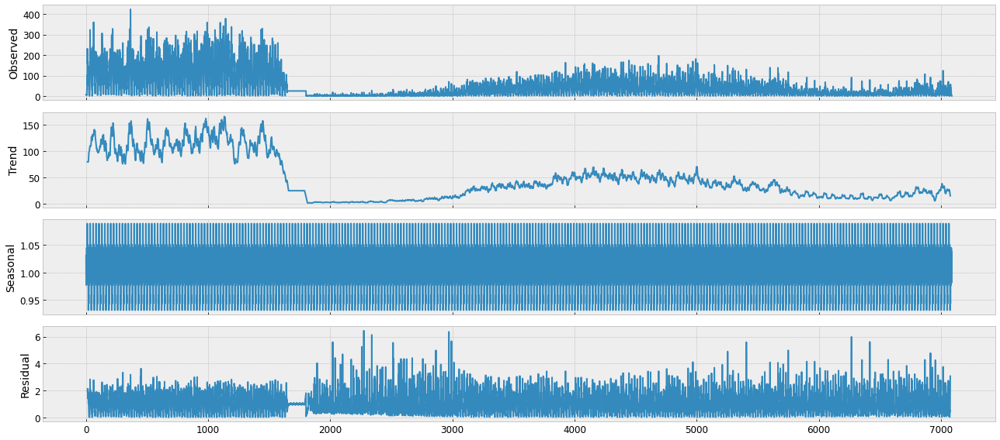

In [ ]:
rcParams['figure.figsize'] = 18, 8
plt.figure(num=None, figsize=(50, 20), dpi=80, facecolor='w', edgecolor='k')
series = df.Aeroporto
result = seasonal_decompose(series, model='multiplicative', freq = 24)
res = result.plot()

**Trindade**

<Figure size 4000x1600 with 0 Axes>

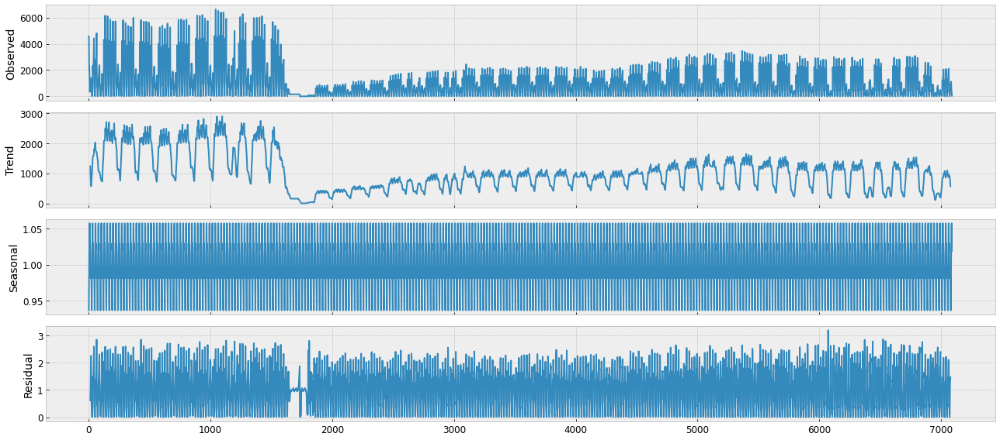

In [ ]:
rcParams['figure.figsize'] = 18, 8
plt.figure(num=None, figsize=(50, 20), dpi=80, facecolor='w', edgecolor='k')
series = df.Trindade
result = seasonal_decompose(series, model='multiplicative', freq = 24)
res = result.plot()

As we can see, we can clearly distinguish two stages in the timeseries. There is a first stage with relatively high peaks, followed by a period of barely no users and then a progressive increase. This is due to the COVID pandemic. Before the pandemic, the metro was one of the most frequented public transportations in the city. Then came the quarantine, where people were not allowed to go out and hence the sudden drop in usage. After said quarantine, we can see that the number of people using this service progressively increased, but far from the original numbers. One reason could be the adaptability to home office and remote work, where people do not need to travel as much anymore to reach their work place

#### **Analysing Traffic**

We add two new columns that indicate de total validations per hour and the average validations between all stops.

In [ ]:
df['Total'] = df.sum(numeric_only=True, axis=1)
df['Average'] = df.mean(numeric_only=True, axis=1)

Extract of days with the most validations values

In [ ]:
df.nlargest(10, 'Total')

Stop,Date,24 de Agosto,Aeroporto,Aliados,Alto da Pêga,Araújo,Azurara,Baguim,Bolhão,Botica,...,Vasco da Gama,Venda-a-Nova,Verdes,Vila do Conde,Vilar do Pinheiro,Viso,Zona Industrial,Árvore,Total,Average
1264,2020-02-27 17:00:00,1048.0,189.0,679.0,16.0,22.0,6.0,46.0,1278.0,39.0,...,92.0,47.0,38.0,89.0,31.0,460.0,72.0,6.0,29936.666667,696.201550
1032,2020-02-17 08:00:00,806.0,117.0,112.0,25.0,76.0,16.0,146.0,229.0,33.0,...,279.0,162.0,41.0,225.0,61.0,351.0,21.0,20.0,29641.666667,689.341085
1042,2020-02-17 18:00:00,1116.0,169.0,741.0,19.0,16.0,5.0,23.0,1114.0,67.0,...,60.0,23.0,40.0,85.0,35.0,678.0,72.0,2.0,29568.333333,687.635659
1063,2020-02-18 18:00:00,1082.0,98.0,753.0,11.0,11.0,8.0,21.0,1183.0,75.0,...,83.0,22.0,25.0,74.0,29.0,625.0,71.0,8.0,29487.000000,685.744186
1075,2020-02-19 08:00:00,773.0,185.0,113.0,18.0,70.0,15.0,143.0,269.0,31.0,...,311.0,172.0,50.0,218.0,58.0,423.0,21.0,14.0,29453.250000,684.959302
1106,2020-02-20 18:00:00,1032.0,240.0,698.0,17.0,17.0,2.0,19.0,1200.0,68.0,...,62.0,28.0,34.0,74.0,40.0,618.0,75.0,5.0,29318.000000,681.813953
1096,2020-02-20 08:00:00,810.0,94.0,109.0,20.0,67.0,16.0,145.0,256.0,32.0,...,277.0,180.0,48.0,217.0,70.0,388.0,16.0,12.0,29285.500000,681.058140
1391,2020-03-04 08:00:00,757.0,181.0,100.0,21.0,64.0,13.0,159.0,178.0,31.0,...,286.0,157.0,48.0,205.0,67.0,379.0,15.0,16.0,28831.500000,670.500000
1053,2020-02-18 08:00:00,767.0,168.0,102.0,23.0,84.0,17.0,153.0,235.0,29.0,...,326.0,164.0,50.0,218.0,67.0,427.0,15.0,16.0,28785.333333,669.426357
1255,2020-02-27 08:00:00,770.0,127.0,104.0,18.0,59.0,14.0,159.0,239.0,32.0,...,282.0,160.0,45.0,184.0,65.0,348.0,16.0,15.0,28731.000000,668.162791


Here we can see the top user traffic hours. As we can see, most of them are either early in the morning (8 am) or late in the afternoon  (5-6 pm). This seems to match with an average working schedule, we will analyse it further in the next sections.

In [ ]:
df.nsmallest(10, 'Total')

Stop,Date,24 de Agosto,Aeroporto,Aliados,Alto da Pêga,Araújo,Azurara,Baguim,Bolhão,Botica,...,Vasco da Gama,Venda-a-Nova,Verdes,Vila do Conde,Vilar do Pinheiro,Viso,Zona Industrial,Árvore,Total,Average
1821,2020-05-02 05:00:00,4.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,4.0,...,3.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,124.0,2.883721
1820,2020-05-02 01:00:00,1.0,1.0,2.0,1.0,1.0,1.0,2.0,2.0,4.0,...,3.0,1.0,1.0,2.0,1.0,2.0,1.0,1.0,127.0,2.953488
1841,2020-05-03 05:00:00,1.0,1.0,1.0,1.0,1.0,4.0,1.0,1.0,3.0,...,2.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,131.0,3.046512
1819,2020-05-02 00:00:00,1.0,1.0,2.0,1.0,1.0,1.0,2.0,2.0,4.0,...,3.0,1.0,1.0,2.0,1.0,2.0,1.0,1.0,133.0,3.093023
1861,2020-05-04 01:00:00,1.0,3.0,2.0,1.0,1.0,2.0,1.0,2.0,1.0,...,3.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,134.0,3.116279
1860,2020-05-04 00:00:00,1.0,3.0,2.0,1.0,1.0,2.0,1.0,2.0,1.0,...,3.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,145.0,3.372093
1840,2020-05-03 00:00:00,4.0,1.0,1.0,1.0,1.0,4.0,1.0,2.0,3.0,...,2.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,148.0,3.441860
1946,2020-05-08 03:00:00,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,2.0,1.0,1.0,3.0,1.0,1.0,150.0,3.488372
1818,2020-05-01 23:00:00,5.0,1.0,2.0,1.0,1.0,1.0,2.0,2.0,4.0,...,3.0,1.0,1.0,2.0,1.0,2.0,1.0,1.0,155.0,3.604651
1945,2020-05-08 01:00:00,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,2.0,1.0,1.0,3.0,1.0,1.0,156.0,3.627907


And here we have exactly the opposite. As expected, the hours with the least amount of traffic are during the night hours.

With all of this in mind, we decided to make a more comprehensive plot and understand how this user traffic evolves throughout the year.

In [ ]:
very_low = "#79bc6a"
low = "#bbcf4c"
medium = "#eec20b"
high = "#f29305"
very_high = "#e8416f"
colors = [very_low, low, medium, high, very_high]


def discrete_colorscale(bvals, colors):
    """
    bvals - list of values bounding intervals/ranges of interest
    colors - list of rgb or hex colorcodes for values in [bvals[k], bvals[k+1]],0<=k < len(bvals)-1
    returns the plotly  discrete colorscale
    """
    if len(bvals) != len(colors)+1:
        raise ValueError('len(boundary values) should be equal to  len(colors)+1')
    bvals = sorted(bvals)     
    nvals = [(v-bvals[0])/(bvals[-1]-bvals[0]) for v in bvals]  #normalized values
    
    dcolorscale = [] #discrete colorscale
    for k in range(len(colors)):
        dcolorscale.extend([[nvals[k], colors[k]], [nvals[k+1], colors[k]]])
    return dcolorscale    

def display_year(z,
                 year: int = None,
                 month_lines: bool = True,
                 fig=None,
                 row: int = None):
    
    if year is None:
        year = datetime.datetime.now().year
    
    data = np.ones(365) * np.nan
    data[:len(z)] = z
    

    d1 = datetime.date(year, 1, 1)
    d2 = datetime.date(year, 12, 31)

    delta = d2 - d1
    
    month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    month_days =   [31,    28,    31,     30,    31,     30,    31,    31,    30,    31,    30,    31]
    month_positions = (np.cumsum(month_days) - 15)/7

    dates_in_year = [d1 + datetime.timedelta(i) for i in range(delta.days+1)] #gives me a list with datetimes for each day a year
    weekdays_in_year = [i.weekday() for i in dates_in_year] #gives [0,1,2,3,4,5,6,0,1,2,3,4,5,6,…] (ticktext in xaxis dict translates this to weekdays
    
    weeknumber_of_dates = [int(i.strftime("%V")) if not (int(i.strftime("%V")) == 1 and i.month == 12) else 53
                           for i in dates_in_year] #gives [1,1,1,1,1,1,1,2,2,2,2,2,2,2,…] name is self-explanatory
    text = [str(i) for i in dates_in_year] #gives something like list of strings like ‘2018-01-25’ for each date. Used in data trace to make good hovertext.
    #4cc417 green #347c17 dark green
    colorscale=discrete_colorscale([0, 1, 2, 3, 4, 5], colors)
    
    # handle end of year
    

    data = [
        go.Heatmap(
            x=weeknumber_of_dates,
            y=weekdays_in_year,
            z=data,
            text=text,
            hoverinfo='text+z',
            xgap=3, # this
            ygap=3, # and this is used to make the grid-like apperance
            showscale=False,
            colorscale=colorscale
        )
    ]
    
        
    if month_lines:
        kwargs = dict(
            mode='lines',
            line=dict(
                color='gray',
                width=1
            ),
            hoverinfo='skip'
            
        )
        for date, dow, wkn in zip(dates_in_year,
                                  weekdays_in_year,
                                  weeknumber_of_dates):
            if date.day == 1:
                data += [
                    go.Scatter(
                        x=[wkn-.5, wkn-.5],
                        y=[dow-.5, 6.5],
                        **kwargs
                    )
                ]
                if dow:
                    data += [
                    go.Scatter(
                        x=[wkn-.5, wkn+.5],
                        y=[dow-.5, dow - .5],
                        **kwargs
                    ),
                    go.Scatter(
                        x=[wkn+.5, wkn+.5],
                        y=[dow-.5, -.5],
                        **kwargs
                    )
                ]
                    
                    
    layout = go.Layout(
        title='Validations traffic through 2020',
        height=250,
        yaxis=dict(
            showline=False, showgrid=False, zeroline=False,
            tickmode='array',
            ticktext=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'],
            tickvals=[0, 1, 2, 3, 4, 5, 6],
            autorange="reversed"
        ),
        xaxis=dict(
            showline=False, showgrid=False, zeroline=False,
            tickmode='array',
            ticktext=month_names,
            tickvals=month_positions
        ),
        margin = dict(t=40),
        showlegend=False
    )

    if fig is None:
        fig = go.Figure(data=data, layout=layout)
        fig.update_layout(plot_bgcolor='rgb(242,242,242)', paper_bgcolor = 'rgb(242,242,242)')
    else:
        fig.add_traces(data, rows=[(row+1)]*len(data), cols=[1]*len(data))
        fig.update_layout(layout, plot_bgcolor='rgb(242,242,242)', paper_bgcolor = 'rgb(242,242,242)')
        fig.update_xaxes(layout['xaxis'])
        fig.update_yaxes(layout['yaxis'])
    
    return fig


def display_years(z, years):
    fig = make_subplots(rows=len(years), cols=1, subplot_titles=years)
    for i, year in enumerate(years):
        data = z[i*365 : (i+1)*365]
        display_year(data, year=year, fig=fig, row=i)
        fig.update_layout(height=250*len(years), width=1300)
        
    return fig

In [ ]:
palette = cycle(px.colors.sequential.Viridis)
df_graph = df[['Date', 'Total']]

# chart
fig = make_subplots(rows=2, cols=2, 
                    specs=[[{"type": "bar"}, {"type": "scatter"}], [{"colspan": 2}, None]],
                    column_widths=[0.4, 0.6], vertical_spacing=0.1, horizontal_spacing=0.1,
                    subplot_titles=("Mean Validations per Day of Week", "Hourly Validations Trend", "Daily Validations Trend"))

# Upper Left chart
df_day = df_graph.groupby([df_graph["Date"].dt.weekday]).mean().reset_index().sort_values(by='Total', ascending = False)
values = list(range(7))
fig.add_trace(go.Bar(x=df_day["Date"], y=df_day['Total'], marker = dict(color=values, colorscale="Viridis"), 
                     name = 'Day of Week'),
                      row=1, col=1)

fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, zeroline = False, row=1, col=1)
fig.update_yaxes(showgrid = False, linecolor='gray',linewidth=2, zeroline = False, row=1, col=1)

# Upper Right chart
df_hour = df_graph.groupby([df_graph["Date"].dt.hour]).mean().reset_index()
fig.add_trace(go.Scatter(x=df_hour["Date"], y=df_hour['Total'], mode='lines+markers',
               name='Hourly CAQI'), row = 1, col = 2)

# Rectangle to highlight range
fig.add_vrect(x0=5, x1=10,
              fillcolor=px.colors.sequential.Viridis[4],
              layer="below", 
              opacity=0.25, 
              line_width=0, 
              row = 1, col = 2
)

fig.add_vrect(x0=15, x1=19,
              fillcolor=px.colors.sequential.Viridis[4],
              layer="below", 
              opacity=0.25, 
              line_width=0, 
              row = 1, col = 2
)

fig.add_annotation(dict(
        x=8,
        y=df_hour.loc[8,'Total'],
        text="There is a <b>peak at <br>8am</b> coinciding with<br>going to work.",
        ax="-20",
        ay="-50",
        showarrow = True,
        arrowhead = 7,
        arrowwidth = 0.7
), row=1, col=2)

fig.add_annotation(dict(
        x=8.5,
        y=1000,
        text="<br><b>Morning rush hours</b>.",
        showarrow = False
), row=1, col=2)

fig.add_annotation(dict(
        x=17,
        y=1000,
        text="<br><b>Evening rush hours</b>.",
        showarrow = False
), row=1, col=2)

fig.add_annotation(dict(
        x=15,
        y=df_hour.loc[15,'Total'],
        text="From 3pm <br> <b>rises again<br> </b>.",
        ax="0",
        ay="-70",
        showarrow = True,
        arrowhead = 7,
        arrowwidth = 0.7
), row=1, col=2)

fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, zeroline = False, row=1, col=2)
fig.update_yaxes(showgrid = False, linecolor='gray', linewidth=2, row=1, col=2)

# Medium Chart
df_week = df_graph.groupby([df_graph["Date"].dt.dayofyear]).mean().reset_index()
fig.add_trace(go.Scatter(x = df_week["Date"], y = df_week['Total'], mode='lines',
                        marker = dict(color = px.colors.sequential.Viridis[5]),
                        name='Daily Validations'), row = 2, col = 1)

from statsmodels.tsa.seasonal import seasonal_decompose
decomp = seasonal_decompose(df_week['Total'], model='additive', freq = 21)

fig.add_trace(go.Scatter(x = df_week["Date"], y = decomp.trend, mode='lines',
                       marker = dict(color = medium),
                        name='Trend'), row = 2, col = 1)
    
fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, row=2, col=1)
fig.update_yaxes(gridcolor = 'gray', gridwidth = 0.15, linecolor='gray',linewidth=2, row=2, col=1)

# General Styling
fig.update_layout(height=650, width=1000, bargap=0.2,
                  margin=dict(b=50,r=30,l=100),
                  title = "<span style='font-size:36px; font-family:Times New Roman'>Validations Analysis</span>",                  
                  plot_bgcolor='rgb(242,242,242)',
                  paper_bgcolor = 'rgb(242,242,242)',
                  font=dict(family="Times New Roman", size= 14),
                  hoverlabel=dict(font_color="floralwhite"),
                  showlegend=False)
fig.show()

z = df_graph.groupby([df_graph["Date"].dt.date])['Total'].mean()
display_year(z, 2020)



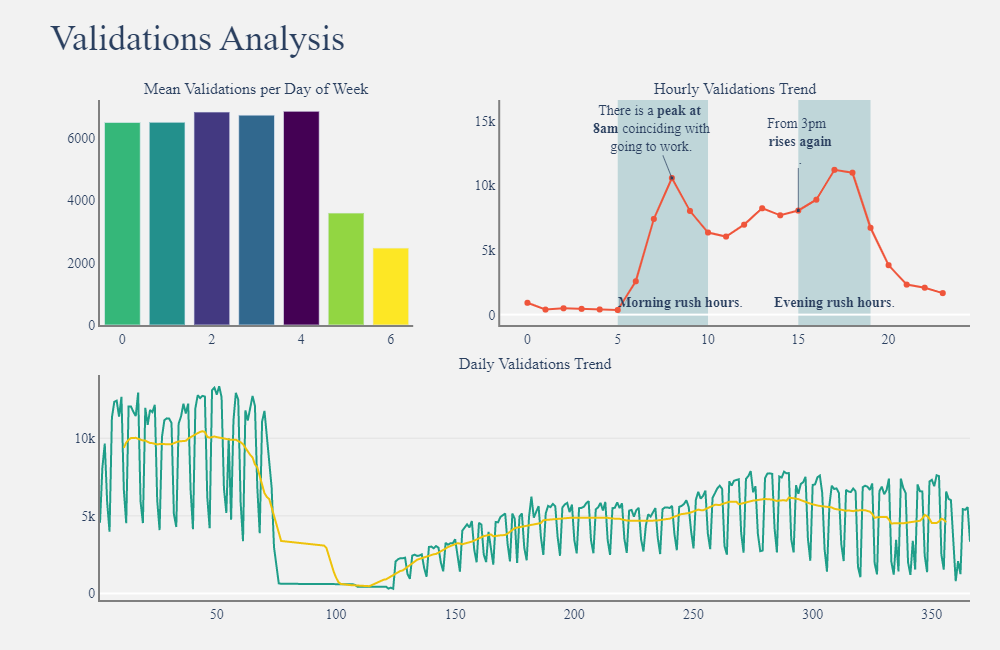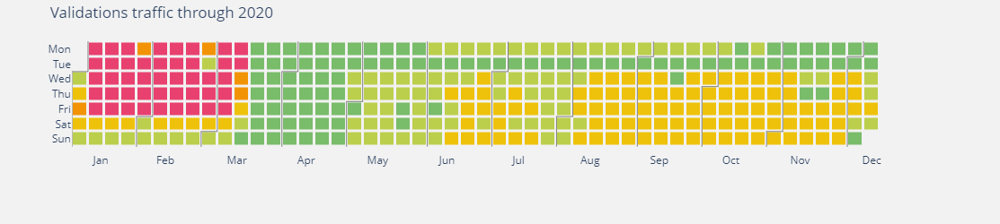

There are a few key takeaways from this plot:

1. The metro service is mostly used during the week and decreases during the weekend. This is expected, as people usually commute to work or university and back.
2. As described before, the user traffic completely matches a standard working schedule, with peaks during morning- and evening rush hours.
3. We can clearly observe the already described COVID impact.
4. Finally, there seems to be a really interesting shift in people's tendencies. Pre-COVID 

### Modelling

#### Data split and Feature engineering

In this section, we create our datasets and splits. For the dataset, because of the change due to COVID-19 in 2020 we train with the months after June (as this are after quarantine), and use December as test.

We also do some feature engineering to choose the best features for our prediction model. We also experimented with many more statistical features, but they were not relevant in the end. We added that to the Appendix.

In [ ]:
def add_datetime_features(df):
    df['year']    = df['Date'].dt.year
    df['month']   = df['Date'].dt.month
    df['day']     = df['Date'].dt.day
    df['week']    = (df['Date'].dt.isocalendar().week).astype("int")
    df['weekday'] = df['Date'].dt.weekday
    df['weekend'] = (df['Date'].dt.weekday >= 5).astype("int")
    df['hour']    = df['Date'].dt.hour
    df['afternoon'] = (df['hour'] >= 12).astype("int")

def get_train_data(df):
  #df = df.drop(df.columns.difference(['Date', target]), 1)
  train_df = df[(df["Date"].dt.month > 5) & (df["Date"].dt.month < 12)]
  test_df = df[df["Date"].dt.month == 12]
  
  add_datetime_features(train_df)
  add_datetime_features(test_df)

  # Time lags
  targets = df.columns.difference(['Date'])
  for t in targets:
    for delta in range(1,8):
        day = train_df.copy()
        day['Date'] = day['Date'] + pd.Timedelta(delta, unit="d")
        name = f'{t}_lag_{delta}'
        day = day.rename(columns={t:name})[['Date', name]]
        train_df = train_df.merge(day, on=['Date'], how='left')

  for t in targets:
    for delta in range(1,8):
        day = train_df.copy()
        day['Date'] = day['Date'] + pd.Timedelta(delta, unit="h")
        name = f'{t}_lag_hour_{delta}'
        day = day.rename(columns={t:name})[['Date', name]]
        train_df = train_df.merge(day, on=['Date'], how='left')

  for t in targets:
    for delta in range(1,8):
        day = test_df.copy()
        day['Date'] = day['Date'] + pd.Timedelta(delta, unit="d")
        name = f'{t}_lag_{delta}'
        day = day.rename(columns={t:name})[['Date', name]]
        test_df = test_df.merge(day, on=['Date'], how='left')

  for t in targets:
    for delta in range(1,8):
        day = test_df.copy()
        day['Date'] = day['Date'] + pd.Timedelta(delta, unit="h")
        name = f'{t}_lag_hour_{delta}'
        day = day.rename(columns={t:name})[['Date', name]]
        test_df = test_df.merge(day, on=['Date'], how='left')

  X_train = train_df.copy()
  X_train = X_train.drop(['Date'], axis=1)
  Y_train = X_train[targets]
  X_train = X_train.drop(targets, axis=1)

  X_test = test_df.copy()
  X_test = X_test.drop(['Date'], axis=1)
  Y_test = X_test[targets]
  X_test = X_test.drop(targets, axis=1)

  return X_train, Y_train, X_test, Y_test


In [ ]:
X_train, Y_train, X_test, Y_test = get_train_data(df)

In [ ]:
X_train

Stop,year,month,day,week,weekday,weekend,hour,afternoon,24 de Agosto_lag_1,24 de Agosto_lag_2,...,Zona Industrial_lag_hour_5,Zona Industrial_lag_hour_6,Zona Industrial_lag_hour_7,Árvore_lag_hour_1,Árvore_lag_hour_2,Árvore_lag_hour_3,Árvore_lag_hour_4,Árvore_lag_hour_5,Árvore_lag_hour_6,Árvore_lag_hour_7
0,2020,6,1,23,0,0,0,0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020,6,1,23,0,0,1,0,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
2,2020,6,1,23,0,0,3,0,NaN,NaN,...,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN
3,2020,6,1,23,0,0,5,0,NaN,NaN,...,1.0,NaN,NaN,NaN,1.0,NaN,1.0,1.0,NaN,NaN
4,2020,6,1,23,0,0,6,0,NaN,NaN,...,1.0,1.0,NaN,1.0,NaN,1.0,NaN,1.0,1.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3960,2020,11,30,49,0,0,19,1,22.0,26.0,...,6.0,6.0,4.0,3.0,3.0,2.0,2.0,2.0,2.0,4.0
3961,2020,11,30,49,0,0,20,1,14.0,15.0,...,20.0,6.0,6.0,3.0,3.0,3.0,2.0,2.0,2.0,2.0
3962,2020,11,30,49,0,0,21,1,12.0,9.0,...,18.0,20.0,6.0,3.0,3.0,3.0,3.0,2.0,2.0,2.0
3963,2020,11,30,49,0,0,22,1,13.0,15.0,...,31.0,18.0,20.0,3.0,3.0,3.0,3.0,3.0,2.0,2.0


In [ ]:
Y_train.columns

Index(['24 de Agosto', 'Aeroporto', 'Aliados', 'Alto da Pêga', 'Araújo',
       'Average', 'Azurara', 'Baguim', 'Bolhão', 'Botica', 'Brito Capelo',
       'Campainha', 'Campanhã', 'Carolina de Michaelis', 'Carreira',
       'Casa da Música', 'Castêlo da Maia', 'Combatentes/Lima', 'Contumil',
       'Crestins', 'Custió', 'Custoias', 'Câmara de Gaia',
       'Câmara de Matosinhos', 'Cândido dos Reis', 'D. João II',
       'Espaço Natureza', 'Esposade', 'Estádio do Dragão', 'Estádio do Mar',
       'Faria Guimarães', 'Fonte do Cuco - Linha P', 'Fonte do Cuco - Linha T',
       'Francos', 'Fânzeres', 'Fórum', 'General Torres', 'H. Pedro Hispano',
       'H. São João', 'Heroísmo', 'IPO', 'ISMAI', 'Jardim do Morro',
       'João de Deus', 'Lapa', 'Levada', 'Lidador', 'Mandim', 'Marquês',
       'Matosinhos Sul', 'Mercado', 'Metro do Porto', 'Mindelo',
       'Modivas Centro', 'Modivas Norte', 'Modivas Sul', 'Nasoni',
       'Nau Vitória', 'Parque da Maia', 'Parque de Real', 'Pedras Rubras',


Our final training set has all stops with their features. We added datetime features and for each stop we also added the most important features in timeseries datasets, lags. We add 7 hour lags and 7 days lags. In this way, the model can use features from other stops for prediction. 

The target dataframe consists of the true value of all stops, average value and total value per hour.

We will look and check at the mutual information of these features to check that they are good features.

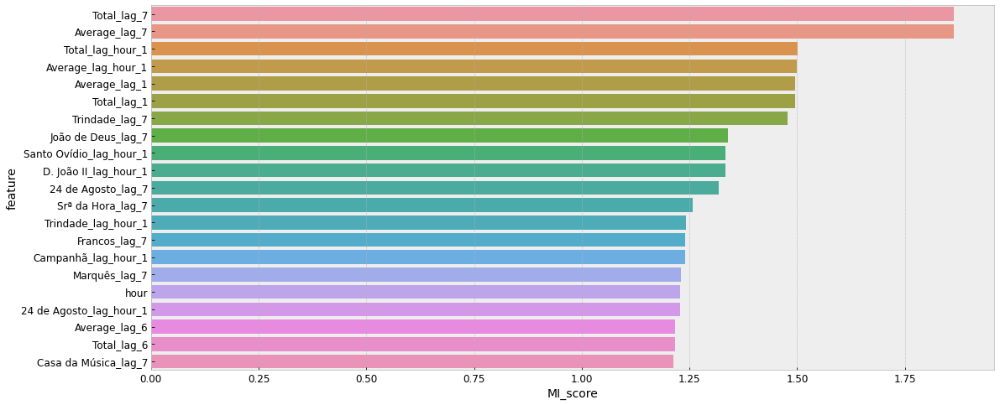

In [ ]:
from sklearn.feature_selection import mutual_info_regression
import seaborn as sns

# Mutual Information does not support Nans, we filled them with 0
Xmi_train = X_train.fillna(0)

mi_scores = mutual_info_regression(Xmi_train[:52173], Y_train['Total'])
mi_scores = pd.Series(mi_scores, name="MI_score", index=Xmi_train.columns)
mi_scores = mi_scores.sort_values(ascending=False)
df_mi_scores = pd.DataFrame(mi_scores).reset_index().rename(columns={'Stop':'feature'})

sns.barplot(y=df_mi_scores['feature'].loc[:20], x=df_mi_scores['MI_score'].loc[:20])

#### Modelling
Now we model with the features we choosed in the last section. We train a MultiOutputRegressor which fits one regressor for each target. This model is really powerful as this lets us predict many different things. We can predict the flow of people for each stop per hour, total flow in all the metro network and average flow. We can combine hourly flow to predict longer time ranges, like daily, monthly or more. We can filter stops by metro line (code in apendix) and predict flow per metro line, or we can predict flow by zone. 

In [ ]:
# fitting
multioutputregressor = MultiOutputRegressor(xgb.XGBRegressor()).fit(X_train, Y_train)

In [ ]:
multioutputregressor.predict(X_test)

array([[19.445007 ,  5.116061 ,  8.913921 , ..., 12.809754 ,  3.8372514,
         1.9706143],
       [20.753822 ,  4.2496896,  9.630684 , ..., 12.809754 ,  4.2544327,
         2.569423 ],
       [20.753822 ,  4.3677635, 10.711178 , ..., 12.809754 ,  4.2544327,
         2.700209 ],
       ...,
       [30.288282 ,  5.0701437, 25.642351 , ...,  9.892529 ,  2.239622 ,
         1.3279673],
       [27.16075  ,  3.0709958, 18.538965 , ...,  9.639302 ,  2.414308 ,
         1.2893572],
       [10.295097 ,  6.029149 , 13.162932 , ...,  6.561092 ,  2.1820445,
         1.2351145]], dtype=float32)

We also train a XGBoost regressor to predict the overall flow of people in the metro network.

[20:33:32] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
1203324.830358159


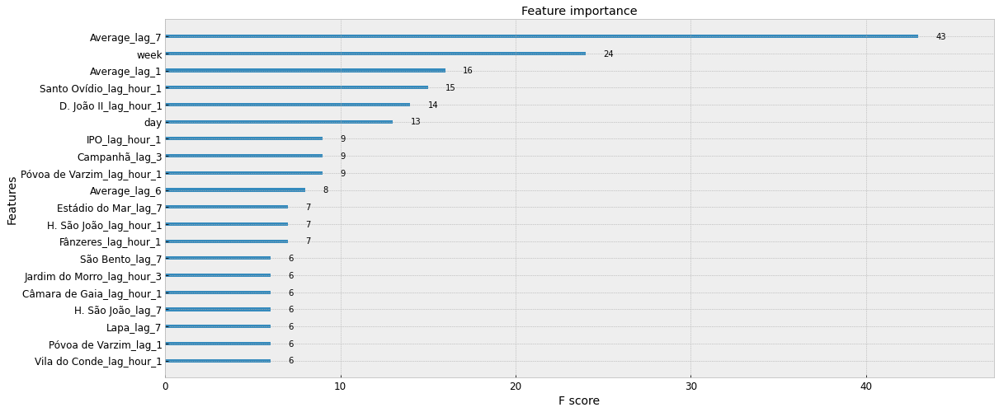

In [ ]:
reg = xgb.XGBRegressor() 
reg.fit(X_train, Y_train['Total'])
xgb.plot_importance(reg, max_num_features=20)

preds = reg.predict(X_test)
print(mean_squared_error(Y_test['Total'], preds))

Average lagged features help the most for the prediction. Interestingly, we can also see which stops help most to do a prediction.

#### Explainability
Explainability of the models is important so we can understand how and why the model has made certain predictions. For this, we can obtain SHAP values. It is more than interesting in this case as we can see which features of which stop helped for the prediction.



In [ ]:
prediction = model.predict(X_test.values)

for i in range(50, 55):
    data_for_prediction = X_test.iloc[[i]]  
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(data_for_prediction.values)
    shap.initjs()
    plt = shap.force_plot(explainer.expected_value, shap_values, data_for_prediction)
    display(plt)

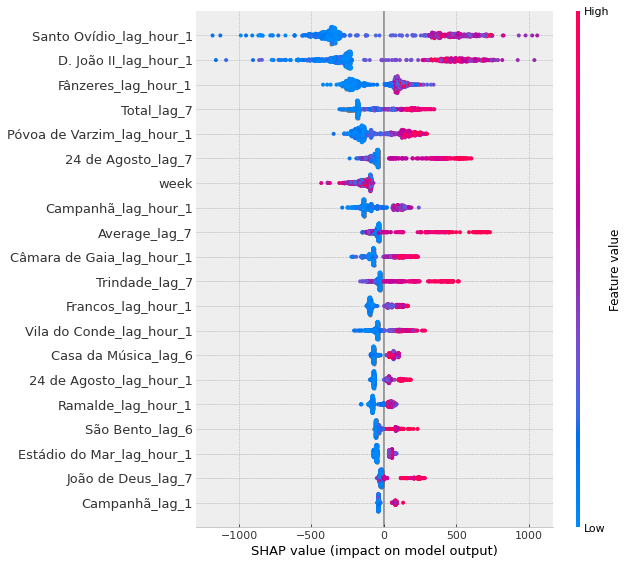

None

In [ ]:
explainer = shap.TreeExplainer(model)    
shap_values = explainer.shap_values(X_test.values)
plt = shap.summary_plot(shap_values, X_test)
display(plt)

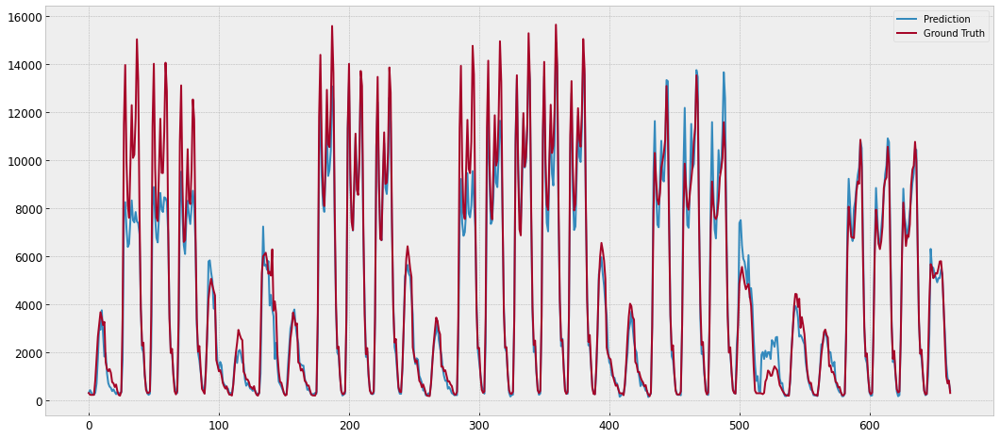

In [ ]:
import matplotlib.pyplot as plt

plt.plot(list(range(len(prediction))), prediction, label='Prediction')
plt.plot(list(range(len(Y_test))), Y_test['Total'], label= 'Ground Truth')
plt.legend()

## 🖼️ Visualisations

We used KeplerGL and created an interactive plot of how the traffic changes over each stop of the metro network. You can choose and play the timeframe you want to visualize, click through lines to see which metro line it is and click through stops to see which stop is and the number of validations on that stop.

In [125]:
%%time
print(f"{'*'*10} Loading Data... {'*'*10}")
df = pd.read_csv("/content/points.csv")
shapes = pd.read_csv("/content/shapes.csv")

********** Loading Data... **********
CPU times: user 90.7 ms, sys: 6.92 ms, total: 97.6 ms
Wall time: 112 ms


In [ ]:
!pip install keplergl

In [129]:
from google.colab import output
output.enable_custom_widget_manager()

In [130]:
# Interactive map
from keplergl import KeplerGl
map_1 = KeplerGl()
map_1.add_data(data=df, name='Stops')
map_1.add_data(data=shapes, name='Lines')
map_1

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'Stops': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 2…

Below we have a video of the interactive visualization

In [ ]:
from IPython.display import HTML 
from base64 import b64encode 

mp4 = open('2022-04-22_15-09-59.mkv','rb').read() 
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(""" <video width=1000 controls> <source src="%s" type="video/mp4"> </video> """ % data_url)

Video in case it does not load -> https://youtu.be/ZtqIuMa8uA0 

#### Trends

**Aeroporto**

<Figure size 4000x1600 with 0 Axes>

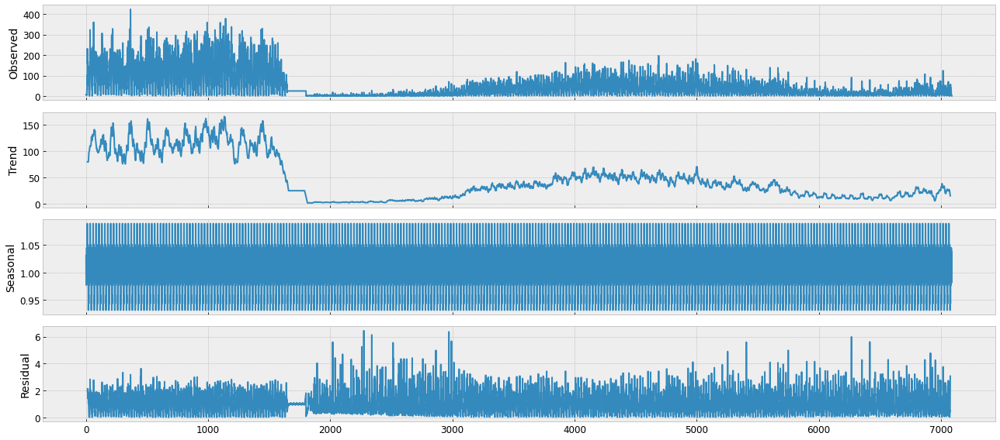

In [ ]:
rcParams['figure.figsize'] = 18, 8
plt.figure(num=None, figsize=(50, 20), dpi=80, facecolor='w', edgecolor='k')
series = pivot.Aeroporto
result = seasonal_decompose(series, model='multiplicative', freq = 24)
res = result.plot()

**Trindade**

<Figure size 4000x1600 with 0 Axes>

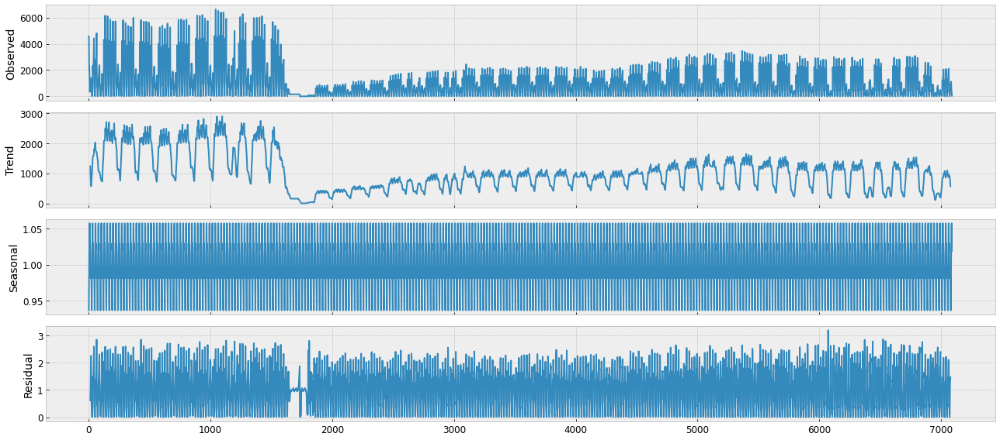

In [ ]:
rcParams['figure.figsize'] = 18, 8
plt.figure(num=None, figsize=(50, 20), dpi=80, facecolor='w', edgecolor='k')
series = pivot.Trindade
result = seasonal_decompose(series, model='multiplicative', freq = 24)
res = result.plot()

### Analysing Traffic

In [ ]:
palette = cycle(px.colors.sequential.Viridis)
df_graph = pivot[['Date', 'Total']]

# chart
fig = make_subplots(rows=2, cols=2, 
                    specs=[[{"type": "bar"}, {"type": "scatter"}], [{"colspan": 2}, None]],
                    column_widths=[0.4, 0.6], vertical_spacing=0.1, horizontal_spacing=0.1,
                    subplot_titles=("Mean Validations per Day of Week", "Hourly Validations Trend", "Daily Validations Trend"))

# Upper Left chart
df_day = df_graph.groupby([df_graph["Date"].dt.weekday]).mean().reset_index().sort_values(by='Total', ascending = False)
values = list(range(7))
fig.add_trace(go.Bar(x=df_day["Date"], y=df_day['Total'], marker = dict(color=values, colorscale="Viridis"), 
                     name = 'Day of Week'),
                      row=1, col=1)

fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, zeroline = False, row=1, col=1)
fig.update_yaxes(showgrid = False, linecolor='gray',linewidth=2, zeroline = False, row=1, col=1)

# Upper Right chart
df_hour = df_graph.groupby([df_graph["Date"].dt.hour]).mean().reset_index()
fig.add_trace(go.Scatter(x=df_hour["Date"], y=df_hour['Total'], mode='lines+markers',
               name='Hourly CAQI'), row = 1, col = 2)

# Rectangle to highlight range
fig.add_vrect(x0=5, x1=10,
              fillcolor=px.colors.sequential.Viridis[4],
              layer="below", 
              opacity=0.25, 
              line_width=0, 
              row = 1, col = 2
)

fig.add_vrect(x0=15, x1=19,
              fillcolor=px.colors.sequential.Viridis[4],
              layer="below", 
              opacity=0.25, 
              line_width=0, 
              row = 1, col = 2
)

fig.add_annotation(dict(
        x=8,
        y=df_hour.loc[8,'Total'],
        text="There is a <b>peak at <br>8am</b> coinciding with<br>going to work.",
        ax="-20",
        ay="-50",
        showarrow = True,
        arrowhead = 7,
        arrowwidth = 0.7
), row=1, col=2)

fig.add_annotation(dict(
        x=8.5,
        y=1000,
        text="<br><b>Morning rush hours</b>.",
        showarrow = False
), row=1, col=2)

fig.add_annotation(dict(
        x=17,
        y=1000,
        text="<br><b>Evening rush hours</b>.",
        showarrow = False
), row=1, col=2)

fig.add_annotation(dict(
        x=15,
        y=df_hour.loc[15,'Total'],
        text="From 3pm <br> <b>rises again<br> </b>.",
        ax="0",
        ay="-70",
        showarrow = True,
        arrowhead = 7,
        arrowwidth = 0.7
), row=1, col=2)

fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, zeroline = False, row=1, col=2)
fig.update_yaxes(showgrid = False, linecolor='gray', linewidth=2, row=1, col=2)

# Medium Chart
df_week = df_graph.groupby([df_graph["Date"].dt.dayofyear]).mean().reset_index()
fig.add_trace(go.Scatter(x = df_week["Date"], y = df_week['Total'], mode='lines',
                        marker = dict(color = px.colors.sequential.Viridis[5]),
                        name='Daily Validations'), row = 2, col = 1)

from statsmodels.tsa.seasonal import seasonal_decompose
decomp = seasonal_decompose(df_week['Total'], model='additive', freq = 21)

fig.add_trace(go.Scatter(x = df_week["Date"], y = decomp.trend, mode='lines',
                       marker = dict(color = medium),
                        name='Trend'), row = 2, col = 1)
    
fig.update_xaxes(showgrid = False, linecolor='gray', linewidth = 2, row=2, col=1)
fig.update_yaxes(gridcolor = 'gray', gridwidth = 0.15, linecolor='gray',linewidth=2, row=2, col=1)

# General Styling
fig.update_layout(height=650, width=1000, bargap=0.2,
                  margin=dict(b=50,r=30,l=100),
                  title = "<span style='font-size:36px; font-family:Times New Roman'>Validations Analysis</span>",                  
                  plot_bgcolor='rgb(242,242,242)',
                  paper_bgcolor = 'rgb(242,242,242)',
                  font=dict(family="Times New Roman", size= 14),
                  hoverlabel=dict(font_color="floralwhite"),
                  showlegend=False)
fig.show()

z = df_graph.groupby([df_graph["Date"].dt.date])['Total'].mean()
display_year(z, 2020)



Photos in case it does not load:

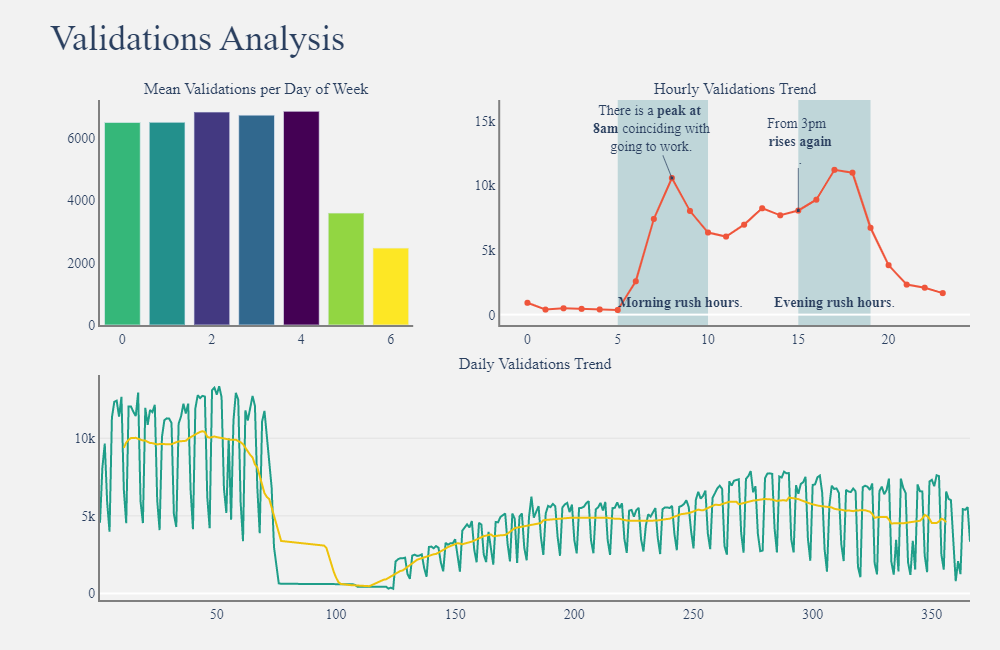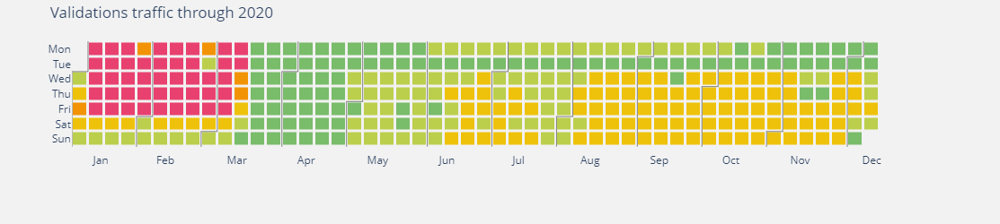

## 👓 References 
List all of the external links (even if they are already linked above), such as external datasets, papers, blog posts, code repositories and any other materials. 
 
Dataset 
* https://wdl-data.fra1.digitaloceanspaces.com/porto/InterMunicipality.zip 
 
Paper 
* https://www.researchgate.net/publication/330877942_Using_Data_Analytics_to_Optimize_Public_Transportation_on_a_College_Campus
* https://arxiv.org/pdf/1912.02574.pdf
 
Resource 
* https://www.linhandante.com/ocasionais-zonas.asp
* https://www.metrodoporto.pt/pages/337
* https://www.metrodoporto.pt/metrodoporto/uploads/document/file/584/freque_encias_jan22_v0122.pdf
* https://www.metrodoporto.pt/pages/307
* https://www.metrodoporto.pt/pages/597?news_id=348
* https://www.metrodoporto.pt/pages/309
* https://docs.kepler.gl/docs/keplergl-jupyter
* https://dash.plotly.com/

## ⏭️ Appendix


Code to filter stops by metro line

In [ ]:
a = "Date' Bolhão'	Câmara de Matosinhos'	Carolina de Michaelis'	Casa da Música'	Estádio do Dragão'	Parque de Real'	Ramalde'	Vasco da Gama'	Francos'	Matosinhos Sul'	Trindade'	Viso'	24 de Agosto'	Estádio do Mar'	Brito Capelo'	Lapa'	Sete Bicas'	Srª da Hora'	Senhor de Matosinhos'	H. Pedro Hispano'	Heroísmo' "
b = "Date' Bolhão'	Carolina de Michaelis'	Casa da Música'	Estádio do Dragão'	Fonte do Cuco - Linha P'	Póvoa de Varzim'	Ramalde'	Verdes'	Campanhã'	Francos'	Trindade'	Viso'	24 de Agosto'	Árvore'	Crestins'	Fonte do Cuco - Linha T'	Lapa'	Sete Bicas'	Srª da Hora'	Alto da Pêga'	Mindelo'	Santa Clara'	Heroísmo'	Portas Fronhas'	São Brás'	Custoias'	Modivas Centro'	Pedras Rubras'	Varziela'	Vila do Conde'	Azurara'	Modivas Norte'	Modivas Sul'	Vilar do Pinheiro'	Lidador'	Espaço Natureza' "
c = "Date' Bolhão'	Carolina de Michaelis'	Casa da Música'	Fonte do Cuco - Linha P'	Fórum'	ISMAI'	Parque da Maia'	Ramalde'	Campanhã'	Francos'	Trindade'	Viso'	24 de Agosto'	Fonte do Cuco - Linha T'		Lapa'	Sete Bicas'	Srª da Hora'	Castêlo da Maia'	Heroísmo'	Cândido dos Reis'	Custió'	Pias'	Zona Industrial'	Araújo'	Mandim' "
d = "Date' Aliados'	Câmara de Gaia'	D. João II'	General Torres'	IPO'	Jardim do Morro'	Marquês'	São Bento'	João de Deus'	Trindade'	Combatentes/Lima'	H. São João'	Polo Universitário'	Salgueiros'	Santo Ovídio'	Faria Guimarães' "
e = "Date' Carolina de Michaelis'	Casa da Música'	Fonte do Cuco - Linha P'	Ramalde'	Verdes'	Francos'	Trindade'	Viso'	Botica'	Crestins'	Fonte do Cuco - Linha T'		Lapa'	Sete Bicas'	Srª da Hora'	Aeroporto'	Custoias'	Esposade' "
f = "Date' Bolhão'	Carolina de Michaelis'	Casa da Música'	Estádio do Dragão'	Nau Vitória'	Ramalde'	Campanhã'	Francos'	Rio Tinto'	Trindade'	Viso'	Campainha'	24 de Agosto'	Fânzeres'	Lapa'	Sete Bicas'	Srª da Hora'	Venda-a-Nova'	Baguim'	Heroísmo'	Carreira'	Contumil'	Levada'	Nasoni' "

def get_line_df(a):
  l = a.split("' ")
  dfA = df[l[:-1]]
  dfA['Total'] = dfA.sum(numeric_only=True, axis=1)
  return dfA

lineaA = get_line_df(a)
lineaB = get_line_df(b)
lineaC = get_line_df(c)
lineaD = get_line_df(d)
lineaE = get_line_df(e)
lineaF = get_line_df(f)

#### Dickey-Fuller test and correlations

In [ ]:
def tsplot(y, lags=None, figsize=(12, 7), syle='bmh'):
    if not isinstance(y, pd.Series):
        y = pd.Series(y)

    with plt.style.context(style='bmh'):
        fig = plt.figure(figsize=(12, 7))
        layout = (3, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        mean_std_ax = plt.subplot2grid(layout, (2, 0), colspan=2)
        y.plot(ax=ts_ax)
        p_value = sm.tsa.stattools.adfuller(y)[1]
        hypothesis_result = "We reject stationarity" if p_value <= 0.05 else "We can not reject stationarity"
        ts_ax.set_title(
            'Time Series stationary analysis Plots\n Dickey-Fuller: p={0:.5f} Result: {1}'.format(p_value, hypothesis_result))
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax)
        plt.tight_layout()

        rolmean = y.rolling(window=8760).mean()
        rolstd = y.rolling(window=8760).std()

        # Plot rolling statistics:
        orig = plt.plot(y, label='Original')
        mean = plt.plot(rolmean, color='red', label='Rolling Mean')
        std = plt.plot(rolstd, color='black', label='Rolling Std')
        plt.legend(loc='best')
        plt.title('Rolling Mean & Standard Deviation')

##### Stop: 24 de Agosto

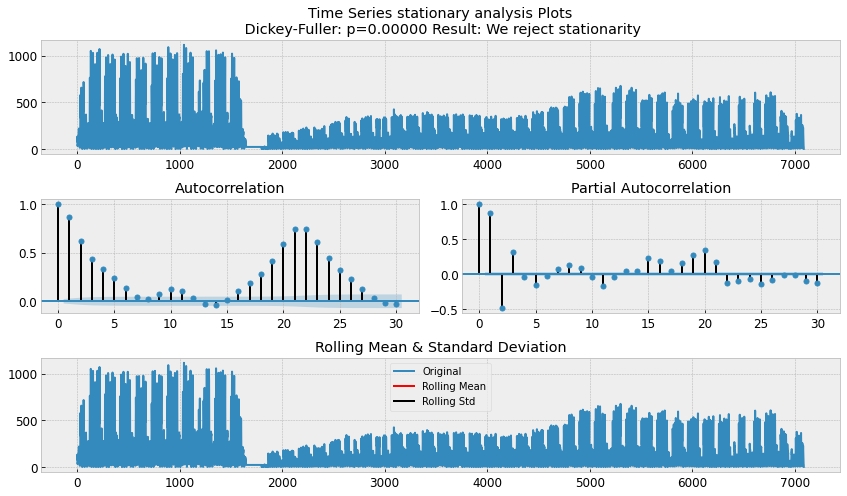

In [ ]:
tsplot(pivot['24 de Agosto'], lags=30)

##### Aeroporto

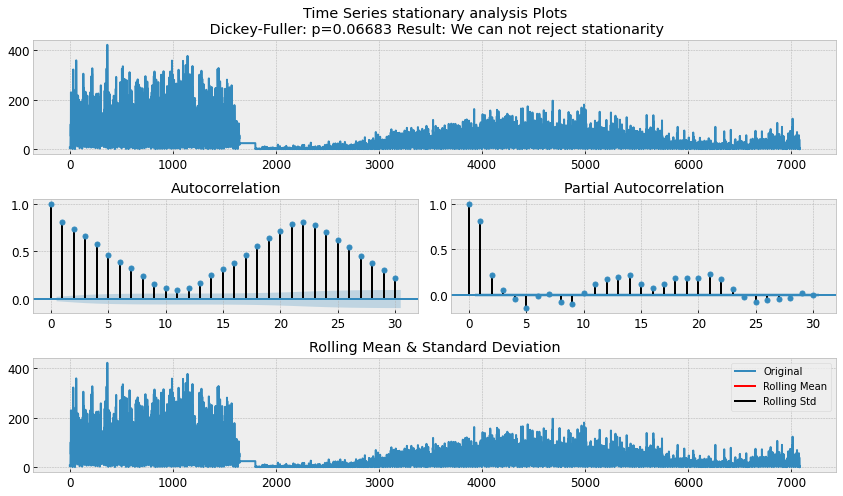

In [ ]:
tsplot(pivot.Aeroporto, lags=30)

##### Botica

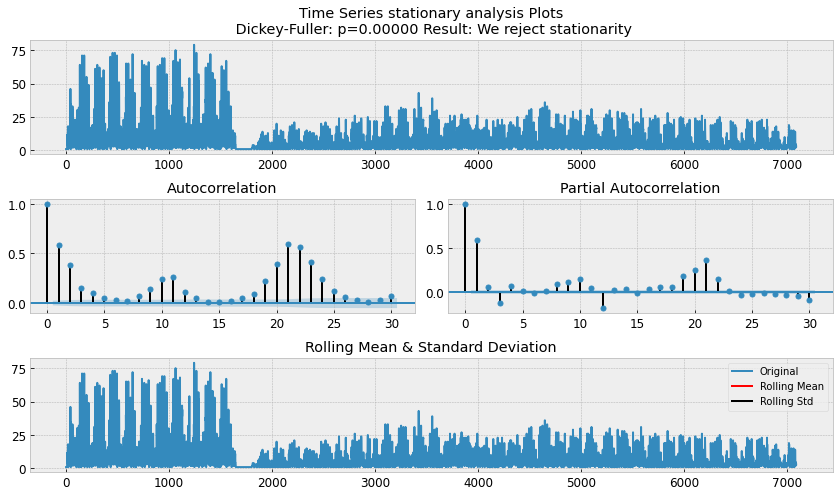

In [ ]:
tsplot(pivot.Botica, lags=30)

##### Verdes

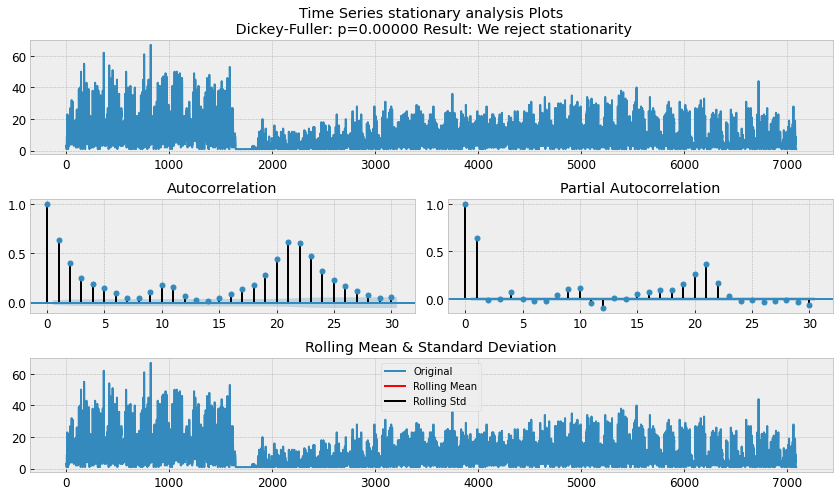

In [ ]:
tsplot(pivot.Verdes, lags=30)

#### Permutation Importance

In [ ]:
def add_datetime_features(df):
    df['year']    = df['Date'].dt.year
    df['month']   = df['Date'].dt.month
    df['day']     = df['Date'].dt.day
    df['week']    = (df['Date'].dt.isocalendar().week).astype("int")
    df['weekday'] = df['Date'].dt.weekday
    df['weekend'] = (df['Date'].dt.weekday >= 5).astype("int")
    df['hour']    = df['Date'].dt.hour
    df['afternoon'] = (df['hour'] >= 12).astype("int")

add_datetime_features(train_df)
add_datetime_features(test_df)

We also tested some statistical features, but they were not as useful.

In [ ]:
# Statistical features

def add_stats_features(df):
  targets = ['Total']
  for t in targets:
    medians = pd.DataFrame(df.groupby(['weekday', 'hour'])[t].median().astype(int)).reset_index()
    medians = medians.rename(columns={t:f'{t}_median'})
    df = df.merge(medians, on=['weekday', 'hour'], how='left')

    stds = pd.DataFrame(df.groupby(['weekday', 'hour'])[t].std()).reset_index()
    stds = stds.rename(columns={t:f'{t}_std'})
    df = df.merge(stds, on=['weekday', 'hour'], how='left')

    mins = pd.DataFrame(df.groupby(['weekday', 'hour'])[t].min().astype(int)).reset_index()
    mins = mins.rename(columns={t:f'{t}_min'})
    df = df.merge(mins, on=['weekday', 'hour'], how='left')

    maxs = pd.DataFrame(df.groupby(['weekday', 'hour'])[t].max().astype(int)).reset_index()
    maxs = maxs.rename(columns={t:f'{t}_max'})
    df = df.merge(maxs, on=['weekday', 'hour'], how='left')

    df_mornings = df[(df.hour >= 6) & (df.hour < 12)]
    morning_avgs = pd.DataFrame(df_mornings.groupby(['month', 'day'])[t].median().astype(int)).reset_index()
    morning_avgs = morning_avgs.rename(columns={t:f'{t}_morning_avg'})
    df = df.merge(morning_avgs, on=['month', 'day'], how='left')

    quantile25 = pd.DataFrame(df.groupby(['weekday', 'hour'])[t].quantile([.25]).astype(int)).reset_index()
    quantile25 = quantile25.rename(columns={t:f'{t}_quantile25'}).drop(['level_2'], axis=1)
    df = df.merge(quantile25, on=['weekday', 'hour'], how='left')

    quantile75 = pd.DataFrame(df.groupby(['weekday', 'hour'])[t].quantile([.75]).astype(int)).reset_index()
    quantile75 = quantile75.rename(columns={t:f'{t}_quantile75'}).drop(['level_2'], axis=1)
    df = df.merge(quantile75, on=['weekday', 'hour'], how='left')

add_stats_features(train_df)
add_stats_features(test_df)

In [ ]:
targets = ['Total']

X_train = train_df.copy()
X_train = X_train.drop(['Date'], axis=1)
Y_train = X_train['Total']
X_train = X_train.drop(targets, axis=1)

X_test = test_df.copy()
X_test = X_test.drop(['Date'], axis=1)
Y_test = X_test['Total']
X_test = X_test.drop(targets, axis=1)

In [ ]:
from catboost import CatBoostRegressor
import eli5
from eli5.sklearn import PermutationImportance

model = CatBoostRegressor(logging_level='Silent', random_state=42, eval_metric='MAE', loss_function='MAE').fit(X_train.values, Y_train.values)
perm = PermutationImportance(model, random_state=1).fit(X_test, Y_test)
display(eli5.show_weights(perm, feature_names = X_test.columns.tolist(), top=None))

Weight,Feature
0.6612 ± 0.0272,Total_lag_hour_1
0.1274 ± 0.0188,Total_lag_7
0.0537 ± 0.0070,Total_lag_1
0.0295 ± 0.0041,hour
0.0124 ± 0.0022,Total_lag_hour_4
0.0108 ± 0.0014,Total_lag_hour_5
0.0095 ± 0.0024,weekend
0.0068 ± 0.0022,Total_lag_hour_2
0.0054 ± 0.0047,Total_lag_4
0.0050 ± 0.0016,Total_lag_5


#### PCA

In [ ]:
def plot_variance(pca, width=8, dpi=100):
    # Create figure
    fig, axs = plt.subplots(2, 1)
    n = pca.n_components_
    grid = np.arange(1, n + 1)
    # Explained variance
    evr = pca.explained_variance_ratio_
    axs[0].bar(grid, evr)
    axs[0].set(
        xlabel="Stop", title="% Explained Variance", ylim=(0.0, 0.2)
    )
    # Cumulative Variance
    cv = np.cumsum(evr)
    axs[1].plot(np.r_[0, grid], np.r_[0, cv], "o-")
    axs[1].set(
        xlabel="Stop", title="% Cumulative Variance", ylim=(0.0, 1.0)
    )
    
    # Set up figure
    fig.set(figwidth=width, dpi=100)
    return axs

In [ ]:
train_df

Stop,Date,Total,year,month,day,week,weekday,weekend,hour,afternoon,...,Total_lag_5,Total_lag_6,Total_lag_7,Total_lag_hour_1,Total_lag_hour_2,Total_lag_hour_3,Total_lag_hour_4,Total_lag_hour_5,Total_lag_hour_6,Total_lag_hour_7
0,2020-06-01 00:00:00,582.697674,2020,6,1,23,0,0,0,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020-06-01 01:00:00,390.488372,2020,6,1,23,0,0,1,0,...,NaN,NaN,NaN,582.697674,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-06-01 03:00:00,386.441860,2020,6,1,23,0,0,3,0,...,NaN,NaN,NaN,NaN,390.488372,582.697674,NaN,NaN,NaN,NaN
3,2020-06-01 05:00:00,643.395349,2020,6,1,23,0,0,5,0,...,NaN,NaN,NaN,NaN,386.441860,NaN,390.488372,582.697674,NaN,NaN
4,2020-06-01 06:00:00,4920.558140,2020,6,1,23,0,0,6,0,...,NaN,NaN,NaN,643.395349,NaN,386.441860,NaN,390.488372,582.697674,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3960,2020-11-30 19:00:00,3923.093023,2020,11,30,49,0,0,19,1,...,14071.744186,14377.255814,14296.325581,7886.651163,9050.023256,8238.697674,13468.813953,11526.488372,11249.302326,11360.581395
3961,2020-11-30 20:00:00,2529.069767,2020,11,30,49,0,0,20,1,...,6759.697674,7285.744186,6844.674419,3923.093023,7886.651163,9050.023256,8238.697674,13468.813953,11526.488372,11249.302326
3962,2020-11-30 21:00:00,1614.558140,2020,11,30,49,0,0,21,1,...,3983.790698,4269.069767,4378.325581,2529.069767,3923.093023,7886.651163,9050.023256,8238.697674,13468.813953,11526.488372
3963,2020-11-30 22:00:00,1648.953488,2020,11,30,49,0,0,22,1,...,4938.767442,4222.534884,4295.372093,1614.558140,2529.069767,3923.093023,7886.651163,9050.023256,8238.697674,13468.813953


In [ ]:
X = train_df.copy()
X_t = test_df.copy()

features = train_df.columns.difference(['Date','Total'])
y = X.pop('Total')
X = X.loc[:, features]
X_t = X_t.loc[:, features]
X = X.fillna(0)
X_t = X_t.fillna(0)

from sklearn.decomposition import PCA

# Create principal components
pca = PCA()
X_pca = pca.fit_transform(X)
X_t_pca = pca.transform(X_t)

# Convert to dataframe
component_names = [f"PC{i+1}" for i in range(X_pca.shape[1])]
X_pca = pd.DataFrame(X_pca, columns=component_names)
X_t_pca = pd.DataFrame(X_t_pca, columns=component_names)

X_pca.head(3)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22
0,-34832.226846,-10373.784637,6911.993773,691.084139,-642.122989,1541.883698,-1453.993518,-1073.998100,992.638863,-249.612629,...,106.506425,-18.539753,15.376393,-2.978258,-6.759565,2.519536,0.381936,-0.061369,-0.005111,-0.0
1,-34630.463630,-10347.713172,7058.807495,892.419713,-595.490998,1428.603784,-1533.713268,-1158.012426,1241.425410,-244.662501,...,303.034068,98.325201,15.068985,-2.910972,-5.747114,2.531953,0.351850,-0.045268,-0.004945,-0.0
2,-34567.168166,-10133.318291,7310.851759,567.169119,-685.210853,1326.952471,-1319.689237,-952.110331,885.776082,-253.082812,...,107.207181,123.159800,15.465867,-3.518709,-3.969473,2.687546,0.276428,0.008829,-0.005274,-0.0


In [ ]:
loadings = pd.DataFrame(
    pca.components_.T,  # transpose the matrix of loadings
    columns=component_names,  # so the columns are the principal components
    index=X.columns,  # and the rows are the original features
)
loadings.head(6)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22
Stop,,,,,,,,,,,,,,,,,,,,,
Total_lag_1,0.314666,-0.124810,-0.023402,0.125361,0.485314,0.275369,0.410563,-0.321080,-0.133039,0.503234,...,-0.031368,-0.020203,-0.000185,0.000039,0.000003,0.000070,-2.462097e-07,0.000004,4.020688e-08,0.0
Total_lag_2,0.288738,-0.188390,-0.170904,-0.206668,0.500891,0.086402,0.155927,0.461364,0.135474,-0.460258,...,0.014661,0.009704,0.000113,-0.000034,-0.000116,0.000142,8.661545e-06,0.000012,-3.877412e-08,0.0
Total_lag_3,0.289884,-0.193390,-0.238027,-0.365244,0.154660,-0.321480,-0.500504,0.135074,-0.048809,0.291888,...,-0.008612,-0.004014,-0.000022,-0.000026,-0.000048,-0.000017,-1.105444e-05,-0.000007,-3.957746e-08,0.0
Total_lag_4,0.290011,-0.192442,-0.255226,-0.281199,-0.261575,-0.323723,0.048995,-0.514240,-0.074771,-0.056393,...,-0.001279,-0.000286,0.000027,-0.000022,-0.000072,0.000073,4.514394e-06,0.000009,5.837416e-09,0.0
Total_lag_5,0.291585,-0.185654,-0.220947,-0.013218,-0.493302,0.069307,0.511347,0.078561,0.159362,-0.182009,...,0.011572,0.008389,0.000108,-0.000047,-0.000084,-0.000094,-2.812911e-05,-0.000026,-4.092512e-08,0.0
Total_lag_6,0.319049,-0.129516,-0.075645,0.287575,-0.382838,0.260823,-0.191473,0.477802,-0.060482,0.405586,...,-0.017491,-0.011205,-0.000131,-0.000039,-0.000035,0.000039,8.106280e-06,0.000014,-1.108760e-08,0.0


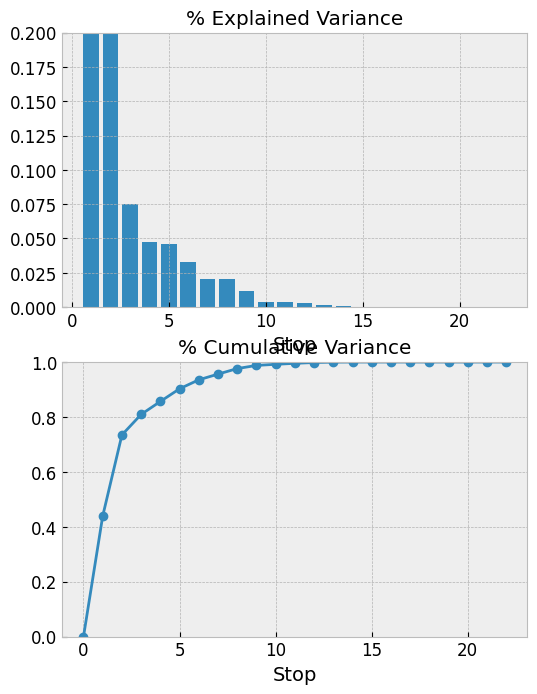

In [ ]:
plot_variance(pca, width=6);

In [ ]:
df_train = pd.concat([df, X_pca], axis=1)
df_test = pd.concat([df, X_t_pca], axis=1)

In [ ]:
from catboost import CatBoostRegressor
import eli5
from eli5.sklearn import PermutationImportance

model = CatBoostRegressor(logging_level='Silent', n_estimators=800, eval_metric='MAE', loss_function='MAE').fit(X_train.values, Y_train.values)
perm = PermutationImportance(model, random_state=1).fit(X_test, Y_test)
display(eli5.show_weights(perm, feature_names = X_test.columns.tolist(), top=None))

Weight,Feature
0.7188 ± 0.0338,Total_lag_hour_1
0.1211 ± 0.0173,Total_lag_7
0.0385 ± 0.0055,Total_lag_1
0.0251 ± 0.0041,hour
0.0133 ± 0.0025,Total_lag_hour_4
0.0131 ± 0.0010,Total_lag_hour_5
0.0130 ± 0.0027,Total_lag_hour_2
0.0075 ± 0.0009,weekday
0.0074 ± 0.0024,weekend
0.0040 ± 0.0028,day
